
**Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones**

**Edición 2022**

---
## Trabajo práctico entregable - Parte 2 Ej 3

In [33]:
#Importamos e instalamos los modulos necesarios

!pip install geopandas
!pip install folium
!wget -nc https://infra.datos.gob.ar/catalog/modernizacion/dataset/7/distribution/7.12/download/provincias.geojson -o provincias.json
!wget -nc https://raw.githubusercontent.com/agustinabdala/diplodatos/main/ProvinciasArgentina.geojson

import folium
import io
import matplotlib
import matplotlib.pyplot as plt
import numpy
import pandas as pd
import seaborn
import geopandas as gpd
from google.colab import files

seaborn.set_context('talk')

File ‘ProvinciasArgentina.geojson’ already there; not retrieving.



## Lectura del dataset

En la notebook 00 se explican los detalles de la siguiente sección.

In [34]:
url = 'https://cs.famaf.unc.edu.ar/~mteruel/datasets/diplodatos/sysarmy_survey_2020_processed.csv'
df = pd.read_csv(url)

In [35]:
# complete here if you want to include more columns
relevant_columns = ['tools_programming_languages', 'salary_monthly_NETO', 'profile_years_experience','work_province', 'profile_studies_level' ]

In [36]:
# Convert the comma-separated string of languages to a list of string.
# Remove 'ninguno de los anteriores' option, spaces and training commas.
def split_languages(languages_str):
  if not isinstance(languages_str, str):
    return []
  # Remove 'other' option
  languages_str = languages_str.lower()\
    .replace('ninguno de los anteriores', '')
  # Split string into list of items
  # Remove spaces and commas for each item
  return [lang.strip().replace(',', '')
          for lang in languages_str.split()]

# Create a new column with the list of languages
df.loc[:, 'cured_programming_languages'] = df.tools_programming_languages\
    .apply(split_languages)
if 'cured_programming_languages' not in relevant_columns:
    relevant_columns.append('cured_programming_languages') 

# Duplicate each row of df for each programming language
# mentioned in the response.
# We only include in df_lang the columns we are going to analyze later, so we
# don't duplicate innecesary information.
df_lang = df.cured_programming_languages\
    .apply(pd.Series).stack()\
    .reset_index(level=-1, drop=True).to_frame()\
    .join(df[relevant_columns])\
    .rename(columns={0: 'programming_language'})
# Horrible programming style! But a lot of data science code can be written with
# as concatenations of functions (pipelines), and there's no elegant way of
# doing that on Python.
#df_lang[:5]

En la columna `programming_language` se encuentra cada lenguaje por separado. Notar que si una respuesta contenía 3 lenguajes, como `"HTML, Javascript, Python"`, la fila ha sido replicada 3 veces. Por ello, hay tres filas con índice 1.

In [37]:
language_count = df_lang.programming_language.value_counts()\
    .reset_index()\
    .rename(columns={'index': 'language', 'programming_language': 'frequency'})
#language_count[:10]

Se seleccionan para el analisis los lenguajes: 'javascript', 'sql', 'html', 'python', 'java'

### Filtrado de lenguajes relevantes

El siguiente código permite seleccionar sólo las filas donde el valor de la columna `programming_language` se encuentre en la lista `interesting_languages`.

In [38]:
# Filter out languages that we want to exclude
# Complete here with your selected list.
interesting_languages = ["python", 'javascript', 'sql', 'html', 'java']
filtered_df_lang = df_lang[df_lang.programming_language.isin(interesting_languages)]
#filtered_df_lang[:5]

In [39]:
#Descartando NaN en salarios
df_draft = filtered_df_lang[filtered_df_lang['salary_monthly_NETO'].notnull()]
#Filtrando años de experiencia <50, hay algunos irracionales
df_draft= df_draft.reindex()

In [40]:
k = 90
percentile_90 = df_draft['salary_monthly_NETO'].quantile(k / 100)
n_below = len(df_draft[df_draft['salary_monthly_NETO'] < percentile_90])
n_above = len(df_draft[df_draft['salary_monthly_NETO'] > percentile_90])
#print('Percentil {} de la columna {}: {}'.format(k, 'salary_monthly_NETO', percentile_90))
#print('% de datos menor que percentil {}: {}'.format(k, n_below / len(df)))
#print('% de datos mayor que percentil {}: {}'.format(k, n_above / len(df)))

In [41]:
df_draft['salary_monthly_NETO'].quantile([.95, .98, .99, .995, .998])

0.950    240000.00
0.980    377344.62
0.990    475000.00
0.995    600000.00
0.998    900000.00
Name: salary_monthly_NETO, dtype: float64

In [42]:
# Funcion para limitar los boxes segun rango intercuartilico
def clean_outliers_q3(dataset, column_name):
    """Returns dataset removing the outlier rows from column @column_name."""
    interesting_col = dataset[column_name]
    # Here we can remove the outliers from both ends, or even add more restrictions.
    mask_outlier = (interesting_col <= (2.5 * interesting_col.quantile(.75)))
    return dataset[mask_outlier]

In [43]:
#Agrupar por años de exp
experiencia = df_draft.groupby(by=['programming_language']).mean()
#experiencia = experiencia['salary_monthly_NETO'].round(decimals = 2).to_frame()

In [44]:
# HTML creado en    1993
# JS creado en      1995
# Python creado en  1991
# JAVA creado en    1995
# SQL cresado en    1989

#Recortando años de experiencia a 31
df_draft = df_draft[(df_draft['profile_years_experience']<31)]


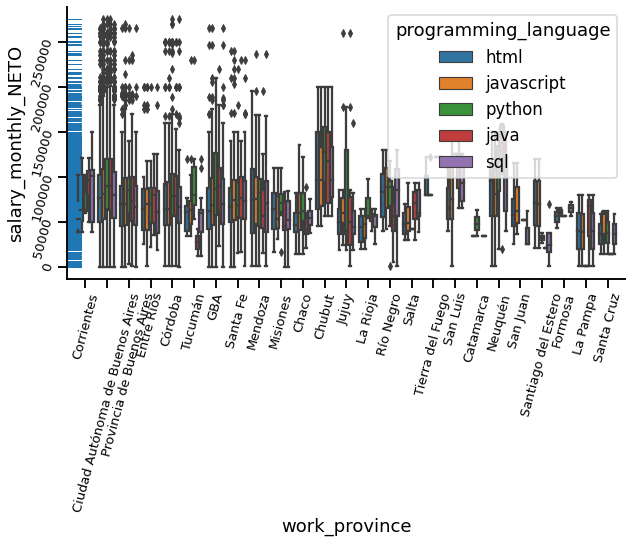

In [45]:
# Graficando:
fig = plt.figure(figsize=(10, 5))
seaborn.boxplot(data= clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'), x='work_province', y='salary_monthly_NETO',  hue='programming_language' ).tick_params(labelsize=13 , rotation=75)
seaborn.rugplot(data=clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO'),y='salary_monthly_NETO')
seaborn.despine()


# **MAPA**

In [46]:
#prov_geo = 'https://dnsg.ign.gob.ar/apps/api/v1/capas-sig/Geodesia+y+demarcaci%C3%B3n/L%C3%ADmites/linea_de_limite_070111/json'
# prov_geo = 'https://dnsg.ign.gob.ar/apps/api/v1/capas-sig/Geodesia+y+demarcaci%C3%B3n/L%C3%ADmites/provincia/json' 
#prov_geo = 'https://infra.datos.gob.ar/catalog/modernizacion/dataset/7/distribution/7.12/download/provincias.geojson'

In [47]:
# We read the file and print it.
#geoJSON_df = gpd.read_file(prov_geo)
geoJSON_df = gpd.read_file('provincias.geojson')
geoJSON_df.sort_values('iso_nombre')


,nombre_completo,fuente,iso_id,nombre,id,categoria,iso_nombre,geometry
22,Provincia de Buenos Aires,IGN,AR-B,Buenos Aires,06,Provincia,Buenos Aires,POINT (-60.55883 -36.67694)
10,Provincia de Catamarca,IGN,AR-K,Catamarca,10,Provincia,Catamarca,POINT (-66.94768 -27.33583)
18,Provincia del Chaco,IGN,AR-H,Chaco,22,Provincia,Chaco,POINT (-60.76583 -26.38643)
6,Provincia del Chubut,IGN,AR-U,Chubut,26,Provincia,Chubut,POINT (-68.52676 -43.78862)
21,Ciudad Autónoma de Buenos Aires,IGN,AR-C,Ciudad Autónoma de Buenos Aires,02,Ciudad Autónoma,Ciudad Autónoma de Buenos Aires,POINT (-58.44586 -34.61449)
13,Provincia de Corrientes,IGN,AR-W,Corrientes,18,Provincia,Corrientes,POINT (-57.80122 -28.77430)
7,Provincia de Córdoba,IGN,AR-X,Córdoba,14,Provincia,Córdoba,POINT (-63.80175 -32.14293)
3,Provincia de Entre Ríos,IGN,AR-E,Entre Ríos,30,Provincia,Entre Ríos,POINT (-59.20145 -32.05887)
19,Provincia de Formosa,IGN,AR-P,Formosa,34,Provincia,Formosa,POINT (-59.93244 -24.89497)
20,Provincia de Jujuy,IGN,AR-Y,Jujuy,38,Provincia,Jujuy,POINT (-65.76425 -23.32008)


In [48]:
df_provincias = clean_outliers_q3(df_draft.reset_index(), 'salary_monthly_NETO')
df_provincias.replace({'GBA':'Provincia de Buenos Aires'}, inplace=True)
df_provincias = df_provincias.groupby(by='work_province').mean('salary_monthly_NETO').reset_index()

In [49]:
df_provincias.sort_values(by='work_province')

,work_province,index,salary_monthly_NETO,profile_years_experience
0,Catamarca,1588.600000,42480.000000,8.000000
1,Chaco,3342.978261,57262.130435,5.934783
2,Chubut,3710.936170,112287.234043,14.744681
3,Ciudad Autónoma de Buenos Aires,2861.589983,87640.665649,8.143203
4,Corrientes,2223.962963,79860.444444,9.333333
5,Córdoba,2827.762346,78837.962469,7.251389
6,Entre Ríos,3054.200000,76359.552476,7.823810
7,Formosa,3831.111111,59238.222222,7.666667
8,Jujuy,3387.166667,64986.651515,5.863636
9,La Pampa,5243.545455,38669.090909,6.363636


In [50]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df['iso_nombre'],df_provincias['work_province'])
missing_states

array(['Buenos Aires'], dtype=object)

In [51]:
geoJSON_df.iloc[22,6] = 'Provincia de Buenos Aires'

In [52]:
missing_states = numpy.setdiff1d(geoJSON_df['iso_nombre'],df_provincias['work_province'])
missing_states

array([], dtype=object)

In [53]:
geoJSON_df = geoJSON_df.rename(columns = {"iso_nombre":"work_province"})

In [54]:
final_df = geoJSON_df.merge(df, on = "work_province")
final_df.head()

,nombre_completo,fuente,iso_id,nombre,id,categoria,work_province,geometry,profile_gender,profile_age,...,profile_sexual_orientation,profile_has_disabilities,profile_has_disabilities_hiring_difficulties,company_employee_number,company_main_activity,company_recommended,company_diversity_policies,company_extra_benefits,company_best_companies_city,cured_programming_languages
0,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,29,...,Heterosexual,NaN,NaN,101-200,Servicios / Consultoría de Software / Digital,5,6,"Capacitaciones y/o cursos, Horarios flexibles,...",NaN,"[javascript, php, sql]"
1,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,39,...,Heterosexual,NaN,No,51-100,Otras industrias,5,6,"Capacitaciones y/o cursos, Estacionamiento gra...",NaN,"[html, java, javascript, php, sql]"
2,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,31,...,Heterosexual,NaN,NaN,11-50,Producto basado en Software,7,5,Ninguna de las anteriores,NaN,"[javascript, php, sql, typescript]"
3,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,32,...,Heterosexual,NaN,NaN,1-10,Producto basado en Software,8,8,"Abono de Internet, Capacitaciones y/o cursos, ...","trabajo en relacion de dependencia, pero remot...","[bash/shell, css, html, javascript, python, ty..."
4,Provincia de Misiones,IGN,AR-N,Misiones,54,Provincia,Misiones,POINT (-54.65170 -26.87540),Hombre,32,...,Heterosexual,NaN,NaN,11-50,Otras industrias,5,6,Ninguna de las anteriores,"ninguna, todo está politizado","[c++, c#]"


In [55]:
# Initialize folium map.
sample_map = folium.Map(location=[-26.8083,-65.2176], zoom_start=4)
sample_map# Set up Choropleth map
folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['work_province','salary_monthly_NETO'],
key_on="feature.properties.work_province",
fill_color='YlGnBu',
fill_opacity=1,
line_opacity=0.2,
legend_name="wills",
smooth_factor=0,
Highlight= True,
line_color = "#0000",
name = "Wills",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(sample_map)

sample_map

In [56]:
#Por si hay que montar el file desde DRIVE
#from google.colab import drive
#drive.mount('/content/drive')

In [57]:
# MAPA CON CONTORNOS DE PROVINCIAS

#FUENTE:
#GEOPANDAS DF de PABLO GOMEZ 
#https://www.kaggle.com/code/pablomgomez21/fuel-market-analysis-argentina-onprogress

#geoJSON_df2 = gpd.read_file('/content/drive/MyDrive/GEOJSON/ProvinciasArgentina.geojson')  #desde DRIVE
geoJSON_df2 = gpd.read_file('/content/ProvinciasArgentina.geojson')  #desde ARCHIVOS COLAB
geoJSON_df2

,nombre,geometry
0,Tucumán,"POLYGON ((-66.20361 -26.62782, -66.04980 -26.6..."
1,Santiago del Estero,"POLYGON ((-64.42108 -26.28356, -65.03906 -27.8..."
2,Salta,"POLYGON ((-66.11572 -26.21459, -65.85205 -26.3..."
3,Jujuy,"POLYGON ((-67.22534 -23.69483, -66.47827 -24.2..."
4,Formosa,"POLYGON ((-62.35840 -24.08659, -58.40332 -26.8..."
5,Chaco,"POLYGON ((-61.74316 -27.13737, -61.65527 -28.0..."
6,Misiones,"POLYGON ((-56.04126 -27.37177, -55.59082 -28.1..."
7,Corrientes,"POLYGON ((-56.03027 -27.37177, -56.31592 -27.4..."
8,Catamarca,"POLYGON ((-68.51074 -25.16517, -68.54370 -25.6..."
9,Córdoba,"POLYGON ((-65.56641 -30.18312, -65.78613 -31.9..."


In [58]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df2['nombre'],df_provincias['work_province'])
missing_states

array(['Buenos Aires', 'Capital Federal'], dtype=object)

In [59]:
#ERROR
geoJSON_df2['nombre'] = geoJSON_df2['nombre'].replace({'Buenos Aires':'Provincia de Buenos Aires', 'Capital Federal':'Ciudad Autónoma de Buenos Aires'})

In [60]:
#provincias que difieren
missing_states = numpy.setdiff1d(geoJSON_df2['nombre'],df_provincias['work_province'])
missing_states

array([], dtype=object)

In [61]:
geoJSON_df2 = geoJSON_df2.rename(columns = {"nombre":"work_province"})

In [62]:
final_df = geoJSON_df2.merge(df_provincias, on = "work_province")
final_df.head()

,work_province,geometry,index,salary_monthly_NETO,profile_years_experience
0,Tucumán,"POLYGON ((-66.20361 -26.62782, -66.04980 -26.6...",3095.224138,66665.172414,7.568966
1,Santiago del Estero,"POLYGON ((-64.42108 -26.28356, -65.03906 -27.8...",4476.750000,46143.583333,10.833333
2,Salta,"POLYGON ((-66.11572 -26.21459, -65.85205 -26.3...",3358.950000,58112.400000,6.850000
3,Jujuy,"POLYGON ((-67.22534 -23.69483, -66.47827 -24.2...",3387.166667,64986.651515,5.863636
4,Formosa,"POLYGON ((-62.35840 -24.08659, -58.40332 -26.8...",3831.111111,59238.222222,7.666667


In [63]:
# Initialize folium map.
provincias_map = folium.Map(width=700, height=700, location=[-26.8083,-65.2176], zoom_start=4)

# Set up Choropleth map
folium.Choropleth(
geo_data=final_df,
data=final_df,
columns=['work_province','salary_monthly_NETO'],
key_on="feature.properties.work_province",
fill_color='YlGnBu',
fill_opacity=1,
line_opacity=0.2,
legend_name="Salario Neto Medio",
smooth_factor=0,
Highlight= True,
line_color = "#0000",
name = "Salario Neto Medio",
show=False,
overlay=True,
nan_fill_color = "White"
).add_to(provincias_map)

provincias_map

In [64]:
provincias_map.save('mapa_export.html')